In [1]:
import numpy as np
import pandas as pd

%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

In [42]:
X_train = pd.read_csv('input/train.csv', header=None, prefix='col')
X_test = pd.read_csv('input/test.csv', header=None, prefix='col') 
y_train = pd.read_csv('input/train-target.csv', header=None, names=['target']) 

df = pd.concat([X_train, y_train], axis=1)

In [43]:
drop_cols = ['col17', 'col22', 'col26', 'col9', 'col15', 'col16']
X_train_dropped = X_train[drop_cols + ['col0', 'col1', 'col2', 'col3', 'col4']]
X_test_dropped = X_test[drop_cols + ['col0', 'col1', 'col2', 'col3', 'col4']]

X_train = X_train.drop(columns=drop_cols)
X_test = X_test.drop(columns=drop_cols)

In [15]:
df.head()

,col0,col1,col2,col3,col4,col5,col6,col7,col8,col9,...,col21,col22,col23,col24,col25,col26,col27,col28,col29,target
0,-220.530530,-70.197440,119.035181,20.711737,-6.152986,52.225051,-23.230903,-166.521871,-41.571463,2.620401,...,46.543585,-80.962171,-146.652218,10.899085,4.370985,4.060272,40.680890,-37.942655,33.838225,1
1,-8.536541,-8.305435,-117.828269,-28.588333,14.223240,-42.087807,-45.538664,58.898976,27.749744,2.545916,...,121.304258,31.507396,88.282912,66.766185,-4.363974,-5.791376,-32.101939,-52.255449,-4.826111,1
2,126.229973,133.463504,-105.511797,-149.110267,-3.673355,-104.302244,5.815395,100.838385,-46.240211,0.141700,...,88.905713,51.475105,-73.257358,108.947287,8.567240,0.116269,-117.205053,-107.835928,-93.990332,0
3,369.571563,11.850181,-299.969407,29.371721,-3.457523,-115.901854,159.134323,-149.741411,-108.847522,0.078277,...,-166.476192,-73.882682,108.222355,19.573192,-2.242024,0.515601,-25.218215,121.674228,-16.877368,0
4,-99.563708,-85.166292,-73.363391,-35.357907,5.437025,-54.892519,56.430532,-49.237377,-50.054608,2.586612,...,209.163125,-22.847302,-62.067337,58.109167,2.862082,0.920341,-132.875142,3.492953,-15.799596,1


In [ ]:
# from pandas_profiling import ProfileReport

# profile = ProfileReport(df, title="Pandas Profiling Report")
# profile.to_file("train.html")

# profile_test = ProfileReport(X_test, title="Pandas Profiling Report")
# profile_test.to_file("test.html")

In [10]:
corr = df.corr().abs()

columns = np.full((corr.shape[0],), True, dtype=bool)
for i in range(corr.shape[0]):
    for j in range(i+1, corr.shape[0]):
        if corr.iloc[i,j] >= 0.95:
            if columns[j]:
                columns[j] = False
selected_columns = df.columns[columns]
data = df[selected_columns]

In [12]:
set(df.columns) - set(selected_columns)

{'col17', 'col22', 'target'}

In [33]:
data.shape

(10000, 28)

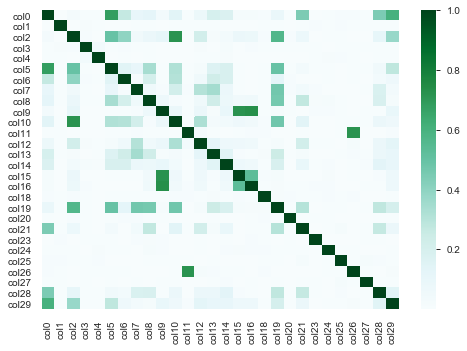

In [35]:
sns.heatmap(data.corr().abs(), cmap='BuGn')

In [48]:
df['target'].value_counts()

1    5051
0    4949
Name: target, dtype: int64

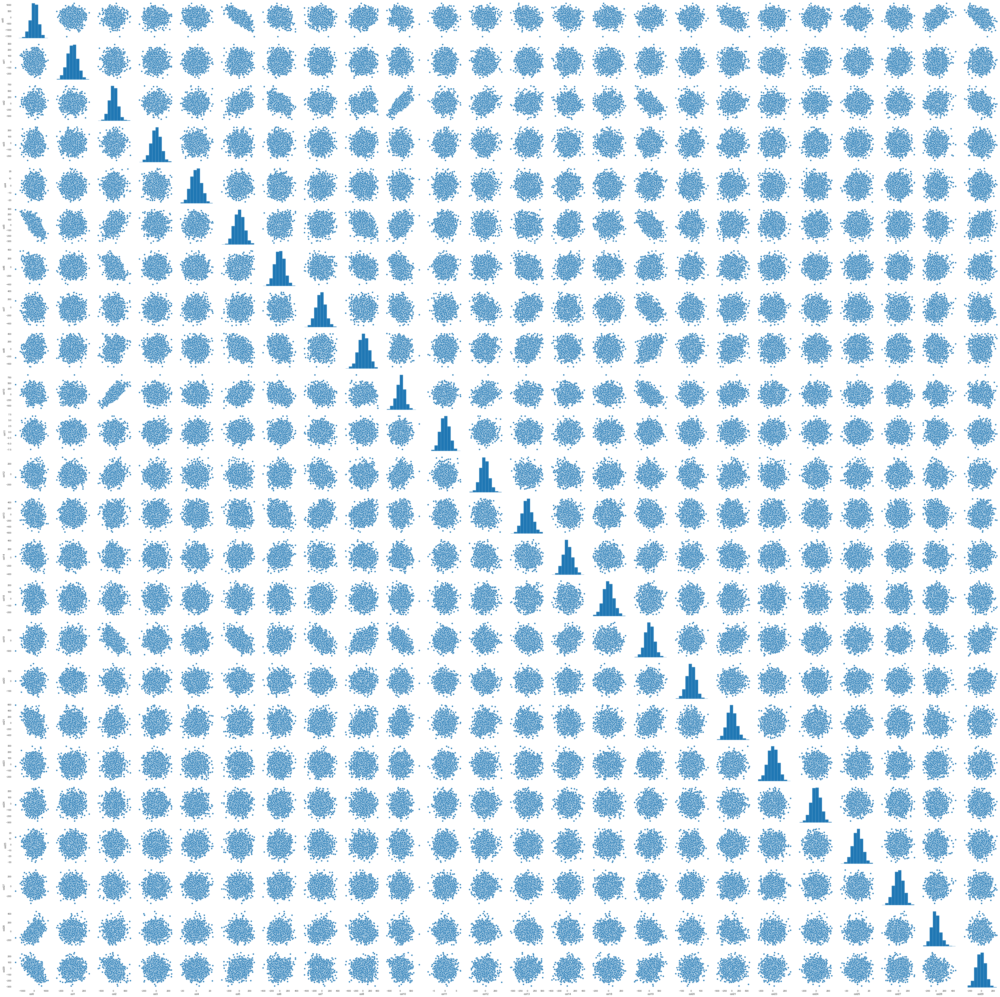

In [16]:
sns.pairplot(X_train.iloc[::5])

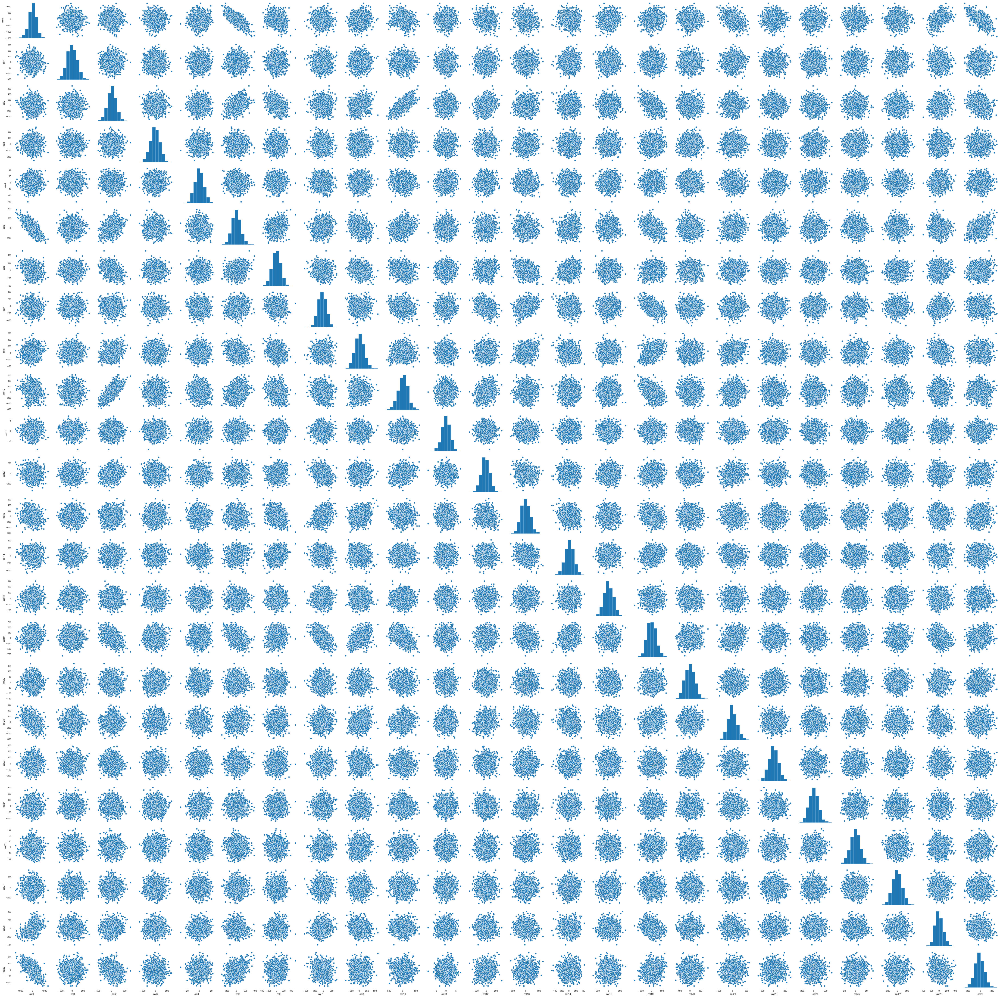

In [17]:
sns.pairplot(X_test)

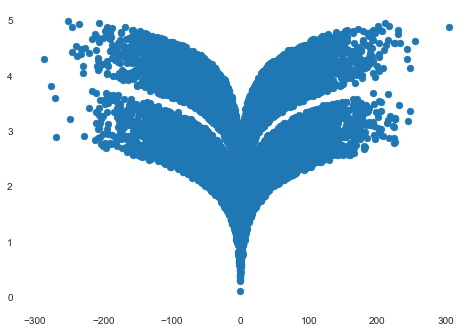

In [42]:
plt.scatter(df['col3'], df['col16'])

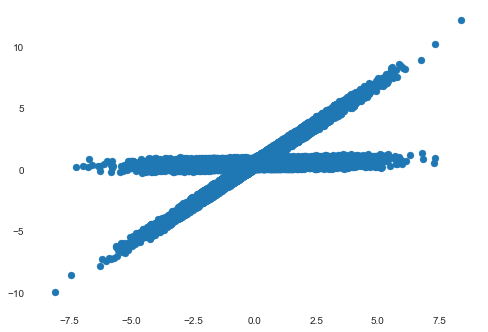

In [44]:
plt.scatter(df['col11'][df['col9'] > 0], df['col26'][df['col9'] > 0])

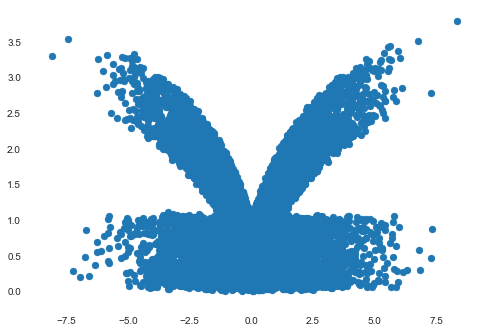

In [47]:
plt.scatter(df['col11'], df['col15'])

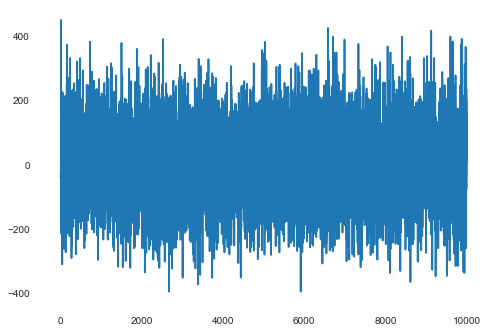

In [28]:
col = X_train.columns[6]
plt.plot(X_train[col])